In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
airbnb = pd.read_csv('../1. raw_data/AB_NYC_2019.csv')
airbnb.shape

(48895, 16)

In [3]:
airbnb.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [4]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [5]:
airbnb.duplicated().sum()
airbnb.drop_duplicates(inplace=True)

In [6]:
airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [7]:
airbnb.drop(['name','id','host_name','last_review'], axis=1, inplace=True)


In [8]:
airbnb.head(5)


,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
2,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1,365
3,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0


In [9]:
airbnb.fillna({'reviews_per_month':0}, inplace=True)

In [10]:
airbnb.reviews_per_month.isnull().sum()

0

In [11]:
airbnb.isnull().sum()

host_id                           0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

Index(['host_id', 'neighbourhood_group', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365'],
      dtype='object')

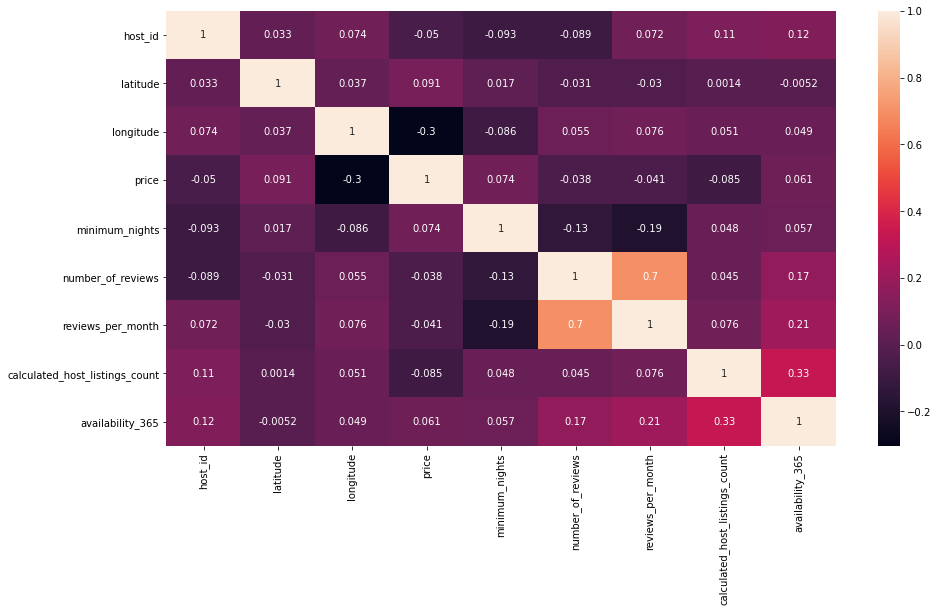

In [12]:
corr = airbnb.corr(method='kendall')
plt.figure(figsize=(15,8))
sns.heatmap(corr, annot=True)
airbnb.columns

In [13]:
airbnb.shape

(48895, 12)

In [14]:
airbnb.tail(5)

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
48890,8232441,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,0.0,2,9
48891,6570630,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,0.0,2,36
48892,23492952,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,0.0,1,27
48893,30985759,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,0.0,6,2
48894,68119814,Manhattan,Hell's Kitchen,40.76404,-73.98933,Private room,90,7,0,0.0,1,23


# data visualization

In [15]:
 import seaborn as sns 

In [16]:
airbnb['neighbourhood_group'].unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

Text(0.5, 1.0, 'neighbourhood group')

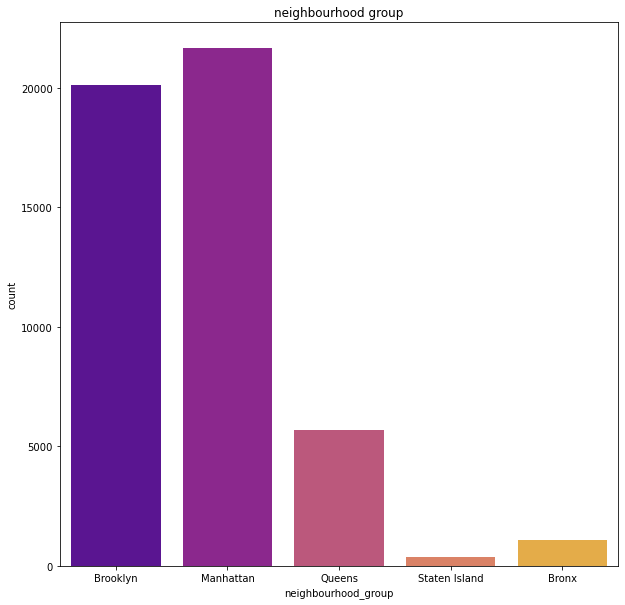

In [17]:
# plot all neighbourhood group 
sns.countplot(airbnb['neighbourhood_group'],palette='plasma')
fig = plt.gcf() #객체 생성 
fig.set_size_inches (10,10)
plt.title('neighbourhood group')

Text(0.5, 1.0, 'neighbourhood')

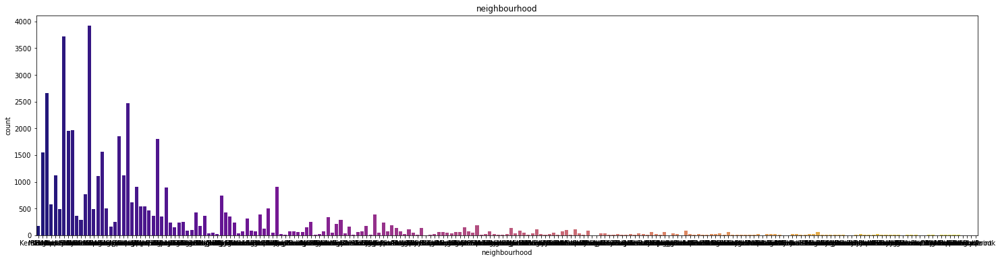

In [18]:
# neighbourhood 
sns.countplot(airbnb['neighbourhood'],palette='plasma')
fig = plt.gcf()
fig.set_size_inches (25,6)
plt.title('neighbourhood')

Text(0.5, 1.0, 'neighbourhood')

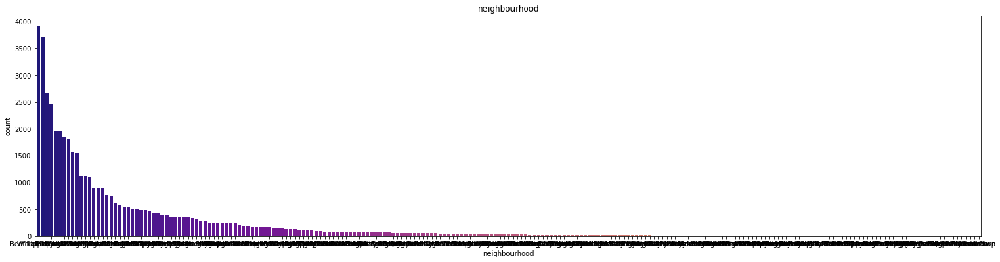

In [19]:
ordered_index = airbnb.neighbourhood.value_counts().index
sns.countplot(airbnb['neighbourhood'],palette='plasma', order=ordered_index)
fig = plt.gcf()
fig.set_size_inches (25,6)
plt.title('neighbourhood')

In [20]:
airbnb.neighbourhood.value_counts().head(10)

Williamsburg          3920
Bedford-Stuyvesant    3714
Harlem                2658
Bushwick              2465
Upper West Side       1971
Hell's Kitchen        1958
East Village          1853
Upper East Side       1798
Crown Heights         1564
Midtown               1545
Name: neighbourhood, dtype: int64

Text(0.5, 1.0, 'room_type')

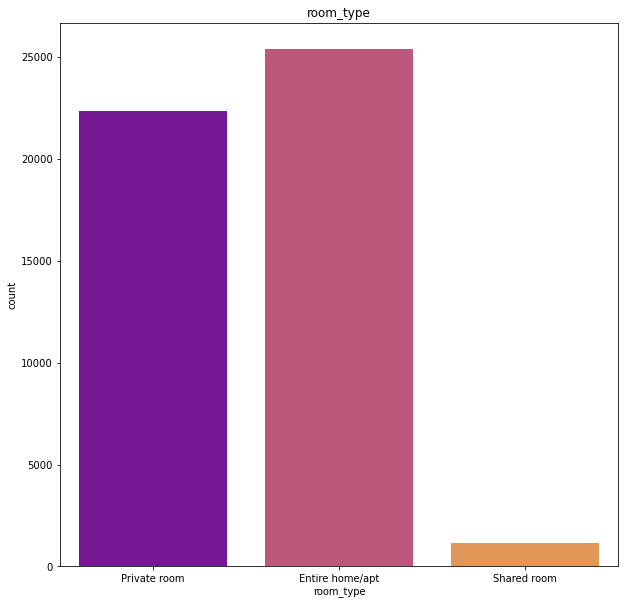

In [22]:
sns.countplot(airbnb['room_type'], palette='plasma')
fig = plt.gcf()
fig.set_size_inches(10,10)
plt.title('room_type')

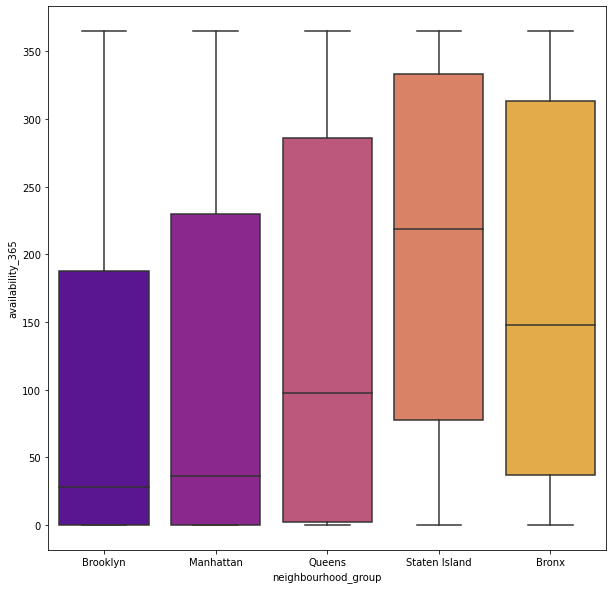

In [23]:
# relation between neighbourgroup and Availability of Room 
# 지역별 예약 가능일 수 

plt.figure(figsize=(10,10))
ax = sns.boxplot(data= airbnb, x= 'neighbourhood_group', y='availability_365', palette='plasma')

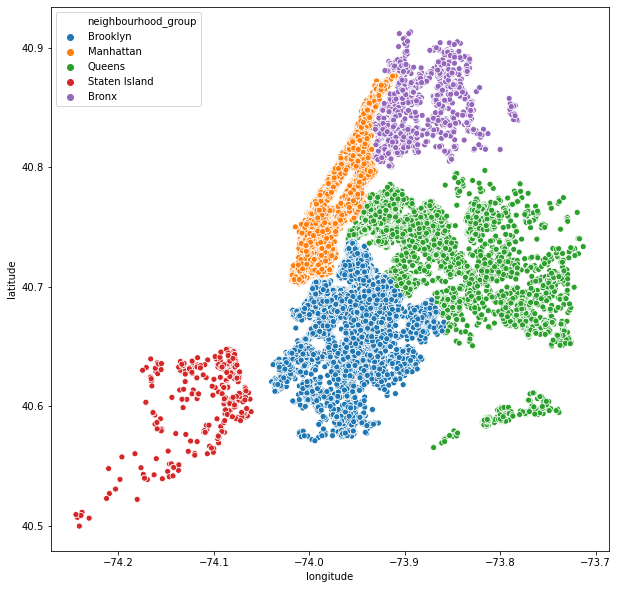

In [25]:
# map of neighbourhood group 지역별 숙소 분포를 확인해보기 

plt.figure(figsize=(10,10))
sns.scatterplot(airbnb.longitude, airbnb.latitude, hue=airbnb.neighbourhood_group)
plt.ioff() #그림과 관련된 명령을 전부 실행시키고 한번에 다 그리는 것 

In [27]:
# # map of neighbourhood 

# plt.figure(figsize=(10,6))
# sns.scatterplot(airbnb.longitude,airbnb.latitude,hue=airbnb.neighbourhood)
# plt.ioff()

# # 동네가 너무 많아 시각화 효과가 없음

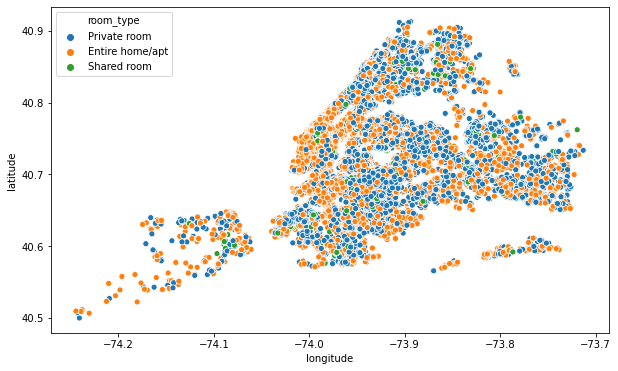

In [29]:
# 방에 따른 분포에 대한 시각화 

plt.figure(figsize=(10,6))
sns.scatterplot(airbnb.longitude, airbnb.latitude, hue= airbnb.room_type)
plt.ioff()

#프라이빗, 전체 집이 대부분임을 확인할 수 있음 

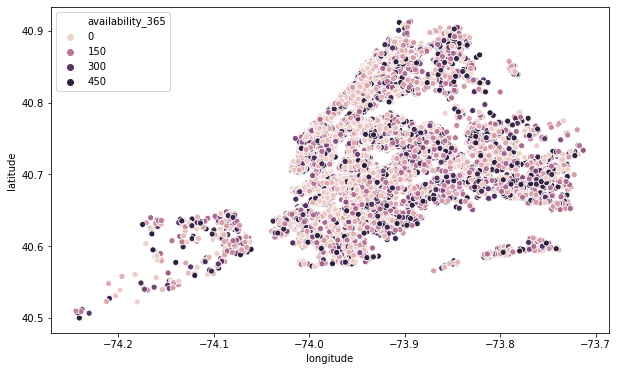

In [30]:
# 예약 가능일 수 

plt.figure(figsize=(10,6))
sns.scatterplot(airbnb.longitude, airbnb.latitude, hue= airbnb.availability_365)
plt.ioff()
# 예약이 안되는 숙소가 꽤 많음 
# 150일 또느 300일 대의 숙소가 대부분임 
# 450일은 어떤 의미인지 확인이 필요함 

In [34]:
# 어떤 동네가 많을 지 워드클라우드를 통해 표현해보기 
from wordcloud import WordCloud

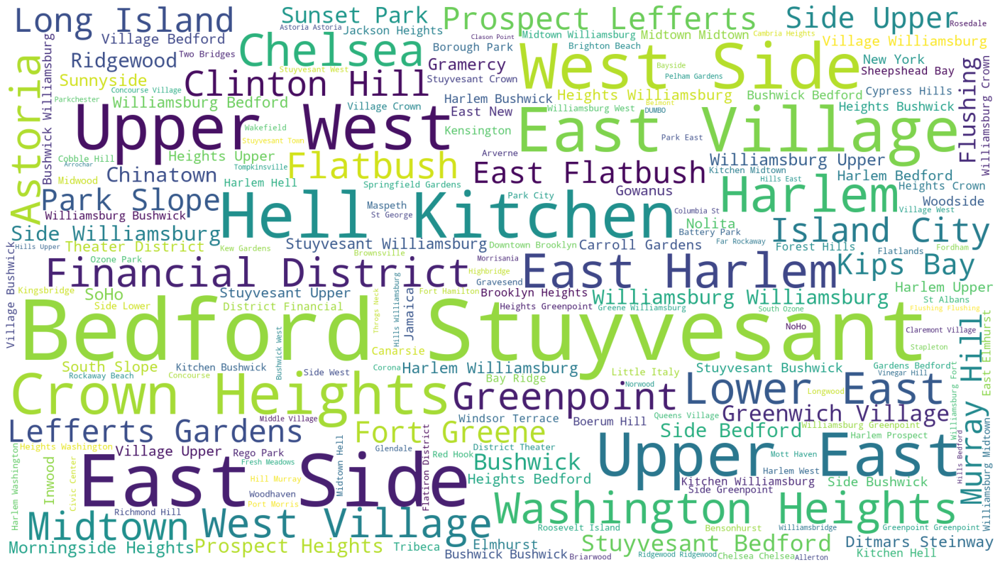

In [36]:
plt.subplots(figsize=(25,15))

# 객체 생성 
wordcloud=WordCloud(
    background_color='white',
    width=1920,
    height=1080
).generate(" ".join(airbnb.neighbourhood))

plt.imshow(wordcloud) #이미지쇼 
plt.axis('off') #축 표시 안함 
plt.show()

# 회귀 분석 

In [39]:
# drop column 타겟에 영향을 미치지 않는 독립변수 제거 

airbnb.drop(['host_id', 'latitude', 'longitude', 'neighbourhood', 'number_of_reviews', 'reviews_per_month'], axis = 1, inplace=True)
airbnb.head()

,neighbourhood_group,room_type,price,minimum_nights,calculated_host_listings_count,availability_365
0,Brooklyn,Private room,149,1,6,365
1,Manhattan,Entire home/apt,225,1,2,355
2,Manhattan,Private room,150,3,1,365
3,Brooklyn,Entire home/apt,89,1,1,194
4,Manhattan,Entire home/apt,80,10,1,0
